<a href="https://colab.research.google.com/github/DanielaCentellas/Coloracion-de-videos-/blob/main/Entrenamiento_modelo_Proyecto.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
from PIL import Image
from sklearn.model_selection import train_test_split
import tensorflow as tf
import numpy as np
from keras.utils.vis_utils import plot_model
from matplotlib import image
from matplotlib import pyplot as plt
import os
import time
import tensorflow as tf
from tensorflow import keras
tf.config.run_functions_eagerly(True)

batch_size = 64
img_size = 120
dataset_split = 324

master_dir = '/content/drive/MyDrive/Proyecto-AI/color_images'
x = []
y = []
c = 0

for image_file in os.listdir( master_dir )[ 0 : dataset_split ]:
    print(image_file)
    rgb_image = Image.open( os.path.join( master_dir , image_file )).resize( ( img_size , img_size ) )
    # Normaliza imagenes RGB
    rgb_img_array = (np.asarray( rgb_image ) ) / 255
    # Conversion RGB to grayscale
    gray_image = rgb_image.convert( 'L' )
    # Normaliza imagen grayscale
    gray_img_array = ( np.asarray( gray_image ).reshape( ( img_size , img_size , 1 ) ) ) / 255
    # Añade a los arrays
    x.append( gray_img_array )
    y.append( rgb_img_array )
    c = c+1

# Division 70% entrenamiento y 30% test
train_x, test_x, train_y, test_y = train_test_split( np.array(x) , np.array(y) , test_size=0.3 )
print(c)
# Construye tf.data.Dataset object
dataset = tf.data.Dataset.from_tensor_slices( ( train_x , train_y ) )
dataset = dataset.batch( batch_size )


color0.png
color50.png
color100.png
color150.png
color200.png
color250.png
color300.png
color350.png
color400.png
color450.png
color500.png
color550.png
color600.png
color650.png
color700.png
color750.png
color800.png
color850.png
color900.png
color950.png
color1000.png
color1050.png
color1100.png
color1150.png
color1250.png
color1200.png
color1300.png
color1350.png
color1400.png
color1450.png
color1500.png
color1550.png
color1600.png
color1650.png
color1700.png
color1750.png
color1800.png
color1850.png
color1900.png
color1950.png
color2000.png
color2050.png
color2100.png
color2150.png
color2200.png
color2250.png
color2300.png
color2350.png
color2400.png
color2450.png
color2500.png
color2550.png
color2600.png
color2650.png
color2700.png
color2750.png
color2800.png
color2850.png
color2900.png
color2950.png
color3000.png
color3050.png
color3100.png
color3150.png
color3200.png
color3250.png
color3300.png
color3350.png
color3400.png
color3450.png
color3500.png
color3550.png
color3600.png
c

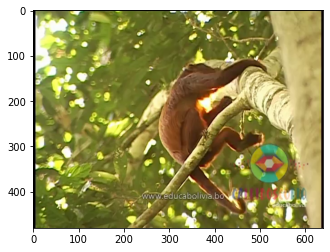

In [ ]:
from PIL import Image
rgb_image = Image.open('/content/drive/MyDrive/Proyecto-AI/color_images/color58000.png')
plt.imshow(rgb_image)

#UNet-GAN
Básicamente, GAN tiene dos redes. Uno es el discriminador que intentará discriminar entre imágenes reales y falsas. Y la segunda red del GAN ​​es el generador que se encargará de generar imágenes falsas pero muy cercanas a las imágenes originales más bien podemos decir que las imágenes falsas estarán en la misma distribución de las imágenes originales.

UNET se utiliza básicamente en problemas de segmentación de imágenes donde las dimensiones de entrada y salida son las mismas.
GAN intenta generar nuevas imágenes a partir de un ruido aleatorio. Entonces, el generador de gan tiene muy pocas dimensiones en la entrada, pero la salida es en gran dimensión.
Puede usar UNET como generador en el GAN ​​(pix2pix usa esto). 

En este caso, generará imágenes falsas no a partir de ruido aleatorio sino de otra imagen de referencia. Tiene otras opciones como red deconvolución, codificador automático, etc. Realmente dependerá de su problema.

https://www.researchgate.net/post/Is_U-Net_a_part_of_Generative_Adversarial_Networks_GAN_Architecture

In [ ]:
# GENERADOR 
def get_generator_model():

    inputs = tf.keras.layers.Input( shape=( img_size , img_size , 1 ) )

    conv1 = tf.keras.layers.Conv2D( 16 , kernel_size=( 5 , 5 ) , strides=1 )( inputs )
    conv1 = tf.keras.layers.LeakyReLU()( conv1 )
    conv1 = tf.keras.layers.Conv2D( 32 , kernel_size=( 3 , 3 ) , strides=1)( conv1 )
    conv1 = tf.keras.layers.LeakyReLU()( conv1 )
    conv1 = tf.keras.layers.Conv2D( 32 , kernel_size=( 3 , 3 ) , strides=1)( conv1 )
    conv1 = tf.keras.layers.LeakyReLU()(conv1)

    conv2 = tf.keras.layers.Conv2D( 32 , kernel_size=( 5 , 5 ) , strides=1)( conv1 )
    conv2 = tf.keras.layers.LeakyReLU()( conv2 )
    conv2 = tf.keras.layers.Conv2D( 64 , kernel_size=( 3 , 3 ) , strides=1 )( conv2 )
    conv2 = tf.keras.layers.LeakyReLU()( conv2 )
    conv2 = tf.keras.layers.Conv2D( 64 , kernel_size=( 3 , 3 ) , strides=1 )( conv2 )
    conv2 = tf.keras.layers.LeakyReLU()(conv2)

    conv3 = tf.keras.layers.Conv2D( 64 , kernel_size=( 5 , 5 ) , strides=1 )( conv2 )
    conv3 = tf.keras.layers.LeakyReLU()( conv3 )
    conv3 = tf.keras.layers.Conv2D( 128 , kernel_size=( 3 , 3 ) , strides=1 )( conv3 )
    conv3 = tf.keras.layers.LeakyReLU()( conv3 )
    conv3 = tf.keras.layers.Conv2D( 128 , kernel_size=( 3 , 3 ) , strides=1 )( conv3 )
    conv3 = tf.keras.layers.LeakyReLU()(conv3)

    bottleneck = tf.keras.layers.Conv2D( 128 , kernel_size=( 3 , 3 ) , strides=1 , activation='tanh' , padding='same' )( conv3 )

    concat_1 = tf.keras.layers.Concatenate()( [ bottleneck , conv3 ] )
    conv_up_3 = tf.keras.layers.Conv2DTranspose( 128 , kernel_size=( 3 , 3 ) , strides=1 , activation='relu' )( concat_1 )
    conv_up_3 = tf.keras.layers.Conv2DTranspose( 128 , kernel_size=( 3 , 3 ) , strides=1 , activation='relu' )( conv_up_3 )
    conv_up_3 = tf.keras.layers.Conv2DTranspose( 64 , kernel_size=( 5 , 5 ) , strides=1 , activation='relu' )( conv_up_3 )

    concat_2 = tf.keras.layers.Concatenate()( [ conv_up_3 , conv2 ] )
    conv_up_2 = tf.keras.layers.Conv2DTranspose( 64 , kernel_size=( 3 , 3 ) , strides=1 , activation='relu' )( concat_2 )
    conv_up_2 = tf.keras.layers.Conv2DTranspose( 64 , kernel_size=( 3 , 3 ) , strides=1 , activation='relu' )( conv_up_2 )
    conv_up_2 = tf.keras.layers.Conv2DTranspose( 32 , kernel_size=( 5 , 5 ) , strides=1 , activation='relu' )( conv_up_2 )

    concat_3 = tf.keras.layers.Concatenate()( [ conv_up_2 , conv1 ] )
    conv_up_1 = tf.keras.layers.Conv2DTranspose( 32 , kernel_size=( 3 , 3 ) , strides=1 , activation='relu')( concat_3 )
    conv_up_1 = tf.keras.layers.Conv2DTranspose( 32 , kernel_size=( 3 , 3 ) , strides=1 , activation='relu')( conv_up_1 )
    conv_up_1 = tf.keras.layers.Conv2DTranspose( 3 , kernel_size=( 5 , 5 ) , strides=1 , activation='relu')( conv_up_1 )

    model_generator = tf.keras.models.Model(inputs , conv_up_1)
    print(model_generator.summary())
    return model_generator 


In [ ]:
get_generator_model()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 120, 120, 1  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 116, 116, 16  416         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 leaky_re_lu (LeakyReLU)        (None, 116, 116, 16  0           ['conv2d[0][0]']                 
                                )                                                             

In [ ]:
# DISCRIMINADOR
def get_discriminator_model():
    layers = [
        tf.keras.layers.Conv2D( 32 , kernel_size=( 7 , 7 ) , strides=1 , activation='relu' , input_shape=( 120 , 120 , 3 ) ),
        tf.keras.layers.Conv2D( 32 , kernel_size=( 7, 7 ) , strides=1, activation='relu'  ),
        tf.keras.layers.MaxPooling2D(),
        tf.keras.layers.Conv2D( 64 , kernel_size=( 5 , 5 ) , strides=1, activation='relu'  ),
        tf.keras.layers.Conv2D( 64 , kernel_size=( 5 , 5 ) , strides=1, activation='relu'  ),
        tf.keras.layers.MaxPooling2D(),
        tf.keras.layers.Conv2D( 128 , kernel_size=( 3 , 3 ) , strides=1, activation='relu'  ),
        tf.keras.layers.Conv2D( 128 , kernel_size=( 3 , 3 ) , strides=1, activation='relu'  ),
        tf.keras.layers.MaxPooling2D(),
        tf.keras.layers.Conv2D( 256 , kernel_size=( 3 , 3 ) , strides=1, activation='relu'  ),
        tf.keras.layers.Conv2D( 256 , kernel_size=( 3 , 3 ) , strides=1, activation='relu'  ),
        tf.keras.layers.MaxPooling2D(),
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense( 512, activation='relu'  )  ,
        tf.keras.layers.Dense( 128 , activation='relu' ) ,
        tf.keras.layers.Dense( 16 , activation='relu' ) ,
        tf.keras.layers.Dense( 1 , activation='sigmoid' ) 
    ]
    model_discriminator = tf.keras.models.Sequential(layers)
    print(model_discriminator.summary())
    return model_discriminator


In [ ]:
get_discriminator_model()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_10 (Conv2D)          (None, 114, 114, 32)      4736      
                                                                 
 conv2d_11 (Conv2D)          (None, 108, 108, 32)      50208     
                                                                 
 max_pooling2d (MaxPooling2D  (None, 54, 54, 32)       0         
 )                                                               
                                                                 
 conv2d_12 (Conv2D)          (None, 50, 50, 64)        51264     
                                                                 
 conv2d_13 (Conv2D)          (None, 46, 46, 64)        102464    
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 23, 23, 64)       0         
 2D)                                                    

In [ ]:
# LOSS 
cross_entropy = tf.keras.losses.BinaryCrossentropy()
mse = tf.keras.losses.MeanSquaredError()

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output) - tf.random.uniform( shape=real_output.shape , maxval=0.1 ) , real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output) + tf.random.uniform( shape=fake_output.shape , maxval=0.1  ) , fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake_output , real_y):
    real_y = tf.cast( real_y , 'float32' )
    return mse( fake_output , real_y )

generator_optimizer = tf.keras.optimizers.Adam( 0.0005 )
discriminator_optimizer = tf.keras.optimizers.Adam( 0.0005 )

generator = get_generator_model()
discriminator = get_discriminator_model()


In [ ]:
#TRAINING
@tf.function
def train_step( input_x , real_y ):
   
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        # Genera una imagen > G( x )
        generated_images = generator( input_x , training=True)
        # Probabilidad de que la imagen sea real -> D( x )
        real_output = discriminator( real_y, training=True)
        # Probabilidad de que la imagen obtenida sea la generada -> D( G( x ) )
        generated_output = discriminator(generated_images, training=True)
        
        # L2 Loss -> || y - G(x) ||^2
        gen_loss = generator_loss( generated_images , real_y )
        # Log loss para el discriminador
        disc_loss = discriminator_loss( real_output, generated_output )
        
        losses["D"].append(disc_loss.numpy())
        losses["G"].append(gen_loss.numpy())

    
    # Calculo de los gradientes
    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    # Optimizacion con Adam
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

generator.compile(
    optimizer=generator_optimizer,
    loss=generator_loss,
    metrics=['accuracy']
)

discriminator.compile(
    optimizer=discriminator_optimizer,
    loss=discriminator_loss,
    metrics=['accuracy']
)

In [ ]:
from tensorflow.keras.models import Sequential, load_model, Model, save_model
def save_my_gan():
    model_path = '/content/drive/MyDrive/Proyecto-AI/models'
    print('Saving GAN models to:', model_path)
    save_model(discriminator, os.path.join(model_path, 'discriminator.hdf5'), overwrite=True)
    print('Saved discriminator.h5...')
    save_model(generator, os.path.join(model_path, 'generator.hdf5'), overwrite=True)
    print('Saved generator.h5...')

In [ ]:
save_model_epoch = 599 
num_epochs = 600
losses = {"D":[], "G":[]}
for epoch in range( num_epochs ):
    print("Running epoch : ", epoch )
    for ( x, y ) in dataset:
        train_step(x ,y)
    if save_model_epoch == epoch and save_model_epoch > 0:
      save_my_gan()

Running epoch :  0
Running epoch :  1
Running epoch :  2
Running epoch :  3
Running epoch :  4
Running epoch :  5
Running epoch :  6
Running epoch :  7
Running epoch :  8
Running epoch :  9
Running epoch :  10
Running epoch :  11
Running epoch :  12
Running epoch :  13
Running epoch :  14
Running epoch :  15
Running epoch :  16
Running epoch :  17
Running epoch :  18
Running epoch :  19
Running epoch :  20
Running epoch :  21
Running epoch :  22
Running epoch :  23
Running epoch :  24
Running epoch :  25
Running epoch :  26
Running epoch :  27
Running epoch :  28
Running epoch :  29
Running epoch :  30
Running epoch :  31
Running epoch :  32
Running epoch :  33
Running epoch :  34
Running epoch :  35
Running epoch :  36
Running epoch :  37
Running epoch :  38
Running epoch :  39
Running epoch :  40
Running epoch :  41
Running epoch :  42
Running epoch :  43
Running epoch :  44
Running epoch :  45
Running epoch :  46
Running epoch :  47
Running epoch :  48
Running epoch :  49
Running ep

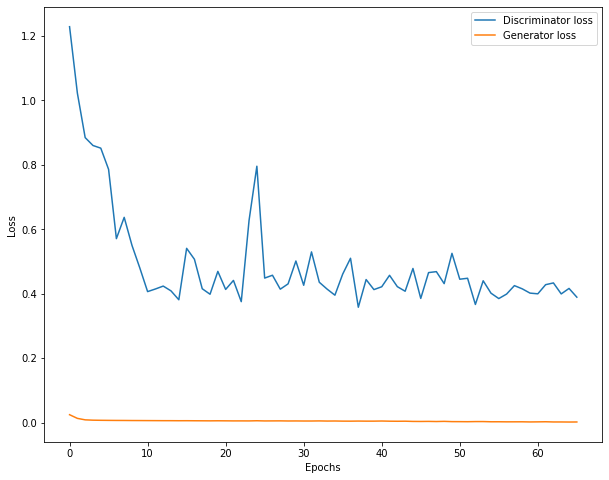

In [ ]:
def plot_loss(losses):

    g_loss = []
    d_loss = []

    count = 0
    for i in losses['D']:
      count += 1
      if(count == 36):
        d_loss.append(i)
        count = 0

    count = 0   
    for i in losses['G']:
      count += 1
      if(count == 36):
        g_loss.append(i)
        count = 0

    plt.figure(figsize=(10,8))
    plt.plot(d_loss, label="Discriminator loss")
    plt.plot(g_loss, label="Generator loss")
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()
plot_loss(losses)

In [ ]:
weights = generator.get_weights()  # Recupera el estado del modelo.
generator.set_weights(weights)

In [ ]:
config = generator.get_config()
weights = generator.get_weights()

In [ ]:
# Guardar configuración JSON
json_config = generator.to_json()
with open('model_config600.json', 'w') as json_file:
    json_file.write(json_config)
# Guardar pesos
generator.save_weights('gan_weights600.h5')

In [ ]:
train = generator(train_x[0 : ]).numpy()

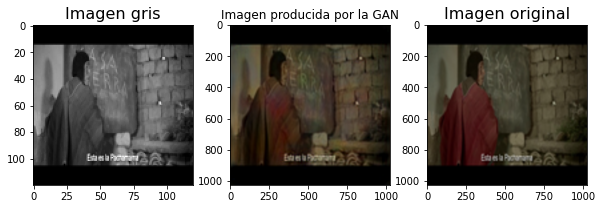

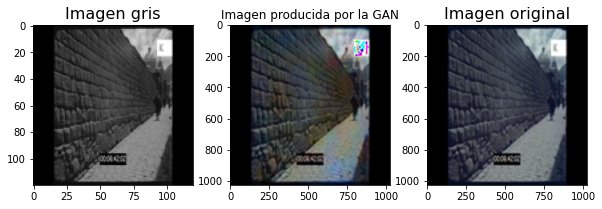

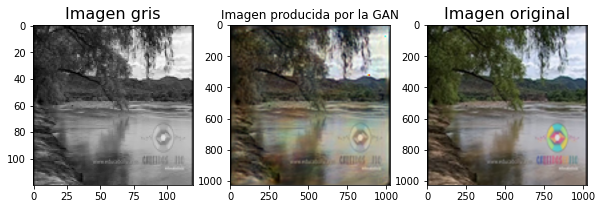

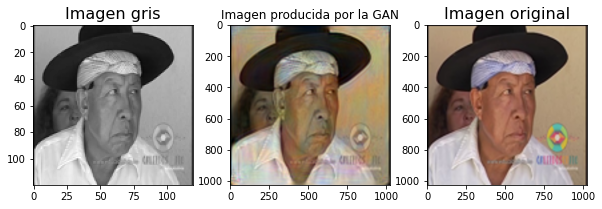

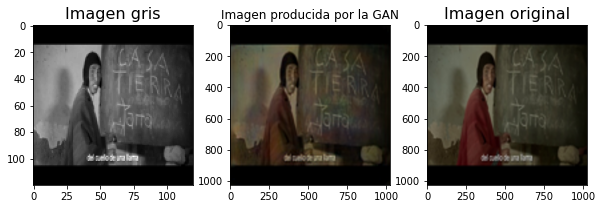

...

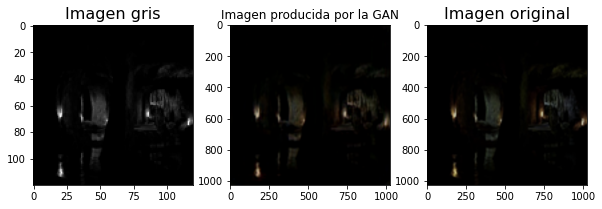

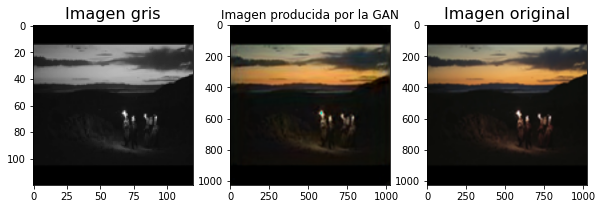

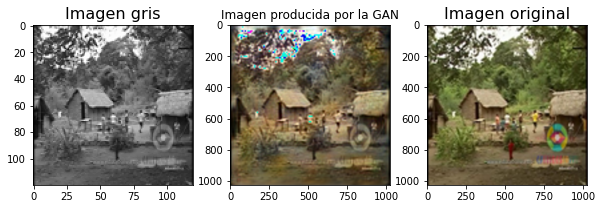

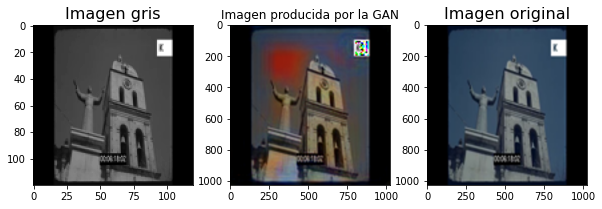

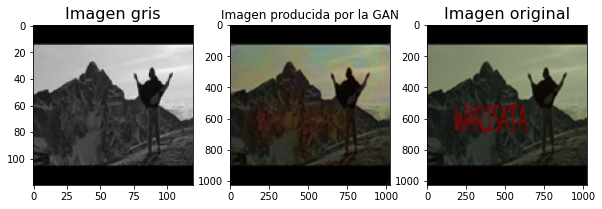

In [ ]:
for i in range (len(train_x)):
  plt.figure(figsize=(10,10))
  or_image = plt.subplot(3,3,1)
  or_image.set_title('Imagen gris', fontsize=16)
  plt.imshow( train_x[i].reshape((120,120)) , cmap='gray' )

  in_image = plt.subplot(3,3,2)    
  image = Image.fromarray((train[i] * 255 ).astype( 'uint8' )).resize(( 1024 , 1024 ))
  image = np.asarray(image)
  in_image.set_title('Imagen producida por la GAN', fontsize=12)
  plt.imshow(image)

  ou_image = plt.subplot(3,3,3)
  image = Image.fromarray( ( train_y[i] * 255 ).astype('uint8')).resize((1024 , 1024))
  ou_image.set_title('Imagen original', fontsize=16)
  plt.imshow( image )

  plt.show()

In [ ]:
test = generator(test_x[0 : ]).numpy()

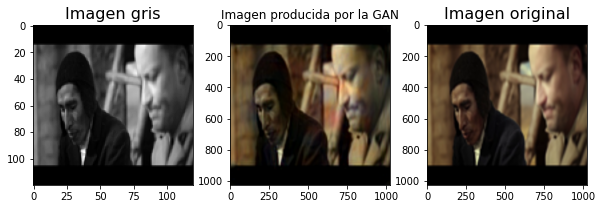

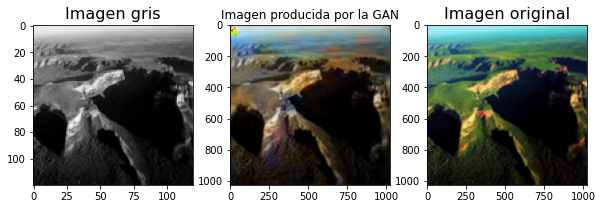

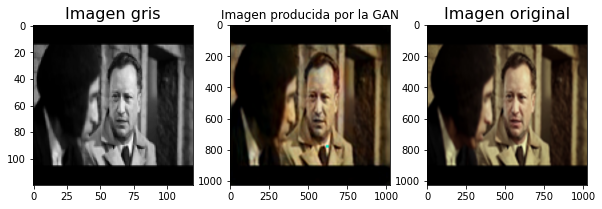

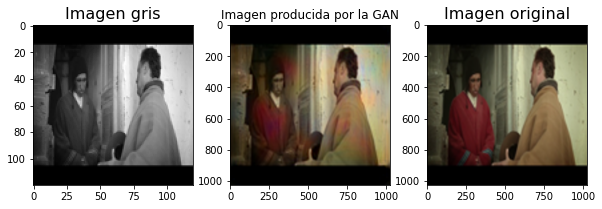

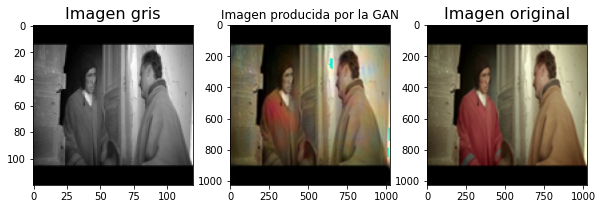

...

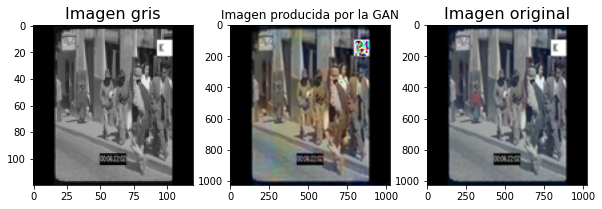

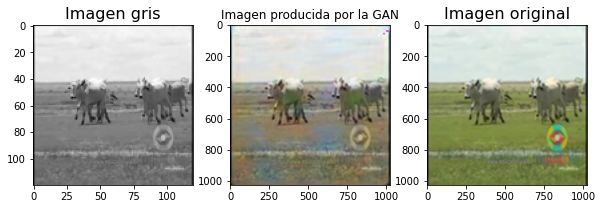

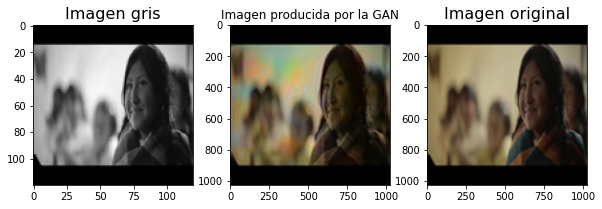

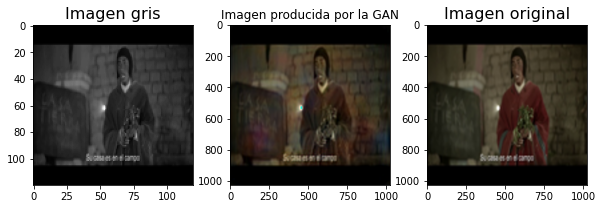

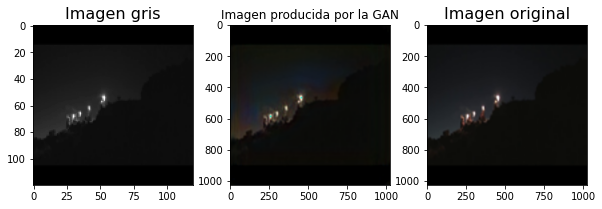

In [ ]:
for i in range (len(test_x)):
  plt.figure(figsize=(10,10))
  or_image = plt.subplot(3,3,1)
  or_image.set_title('Imagen gris', fontsize=16)
  plt.imshow(test_x[i].reshape((120,120)) , cmap='gray')

  in_image = plt.subplot(3,3,2)    
  image = Image.fromarray( ( y[i] * 255 ).astype( 'uint8' ) ).resize( ( 1024 , 1024 ) )
  image = np.asarray( image )
  in_image.set_title('Imagen producida por la GAN', fontsize=12)
  plt.imshow( image )

  ou_image = plt.subplot(3,3,3)
  image = Image.fromarray( ( test_y[i] * 255 ).astype( 'uint8' ) ).resize( ( 1024 , 1024 ) )
  ou_image.set_title('Imagen original', fontsize=16)
  plt.imshow( image )

  plt.show()